<a href="https://colab.research.google.com/github/varun-ml/diffusion-models-tutorial/blob/master/toy-density-estimation/colab_errors.diffusion_model_interpretations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Diffusion models error function prediction, score function prediction, clipping to improve stabalization and other improvements

1. Changes to the train function where we will now be predicting the error and then using it to compute the loss
2. Changes to the generator where we are going to remove the predicted error to obtain the true distribution
3. we will also do some minor improvements and optimizations:
    * sampling from normal distribution using the reparameterization trick
    * using model sequence to write the pytorch model
    * clipping to improve stabalization
    * using the cosine step function
<p> </p> 
4.  Energy function interpretation and the error function interpretation are very similar. We will point out in the code changes to train and generate function for energy function interpretaion 

5. <s> Score generator interpretation (similar to energy interpretation) </s>

<p> Error prediction sampling equation </p>

![Screenshot 2022-10-18 140404.png](attachment:6bee500b-9573-4f35-8f17-8da45ebf21b8.png)

<p> Error prediction training equation </p>

![Screenshot 2022-10-18 135801.png](attachment:ea00941a-eb54-4d19-8fe4-74ade135f278.png)

<p> Energy function sampling equation </p>

![Screenshot 2022-10-18 135722.png](attachment:b996e82a-b440-4fd9-b1e2-053e930ee0eb.png)

<p> Energy function training equation </p>

![Screenshot 2022-10-18 135825.png](attachment:72a1229d-a52a-430e-b984-b25f6451cdce.png)


# issues

1. There is an issue with the generation of samples. At timestep t=T alpha_===1. which makes the mu(x_T)=inf. Could either restrict alphas in a way so that alpha_ at T is < 1 or apply some other techniques to get numerical stability. 
</br>
<font color='red'> Investigating clipping to fix this --  https://github.com/hojonathanho/diffusion/issues/5 </font>


![Screenshot 2022-10-18 135008.png](attachment:bd78bb10-5bb4-45b1-b98a-0f201fbe465a.png)

2. I am not getting desired results with the cosine beta schedule from the hugging face repo. Will investigate how this is implemented in https://github.com/openai/improved-diffusion/blob/783b6740edb79fdb7d063250db2c51cc9545dcd1/improved_diffusion/gaussian_diffusion.py#L36
    * Added clipping to limit range of BETA values, that seems to have fixed the numerical issues 

In [1]:
generate_new_data = True
train_new_model = True
dont_write = True
epochs = 100 # make epoch=300 for better outputs

In [2]:
# utils 
import pickle

def load_cached(filename):
    with open(filename, 'rb') as ff:
        return pickle.load(ff)
    
def write_cached(data, filename):
    with open(filename, 'wb') as ff:
        pickle.dump(data, ff, protocol=pickle.HIGHEST_PROTOCOL)

In [3]:
import os
import os.path as osp

data_paths = osp.join(os.getcwd(), 'saved', 'saved_data')
model_paths = osp.join(os.getcwd(), 'saved','saved_models')

(-20.0, 20.0)

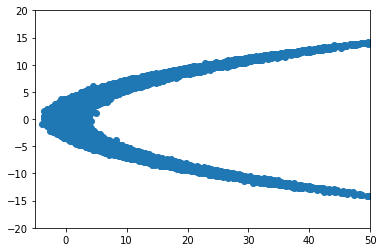

In [4]:
# create a dataset of 10K points, sampled from some complex distribution

import torch
from matplotlib import pyplot as plt

samples = 1024*128

if generate_new_data:
    x = torch.normal(mean=0, std=4, size=(1, samples))
    y = torch.normal(mean=0.25*torch.ones(samples)*x*x, std=torch.ones(samples)*1)
    data = torch.vstack([y, x])
    if not dont_write:
      write_cached(data, os.path.join(data_paths, '2.parabola.pkl'))
else:
    data = load_cached(os.path.join(data_paths, '2.parabola.pkl'))
    y = data[0]
    x = data[1]
    
plt.scatter(y,x)
plt.xlim([-5, 50])
plt.ylim([-20, 20])

(-1.0, 1.0)

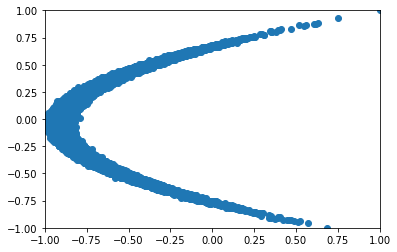

In [5]:
# transform to range
def transform(data):
    min_, max_ = torch.min(data, axis=1), torch.max(data, axis=1)
    data_transformed = 2 * (data.sub(min_.values[:, None])).div((max_.values - min_.values)[:, None]) - 1
    return data_transformed, min_, max_

data_transformed, min_, max_ = transform(data)
plt.scatter(data_transformed[0], data_transformed[1])
plt.xlim([-1, 1])
plt.ylim([-1, 1])

(-20.0, 20.0)

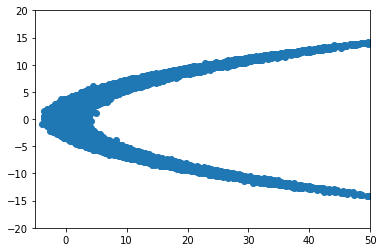

In [6]:
def reverse_transform(data_transformed, min_, max_):
    # data_transformed = 2 * (data.sub(min_.values[:, None])).div((max_.values - min_.values)[:, None]) - 1
    data = (data_transformed + 1).mul((max_.values - min_.values)[:, None]).add(min_.values[:, None]*2)/2
    return data
    
data = reverse_transform(data_transformed, min_, max_)
plt.scatter(data[0], data[1])
plt.xlim([-5, 50])
plt.ylim([-20, 20])

In [7]:
# train model

# ####### i am not getting desired results with the cosine beta schedule from the hugging face repo
def cosine_beta_schedule(timesteps, s=0.008):
    """
    cosine schedule as proposed in https://arxiv.org/abs/2102.09672
    """
    steps = timesteps + 1
    x = torch.linspace(0, timesteps, steps)
    alphas_cumprod = torch.cos(((x / timesteps) + s) / (1 + s) * torch.pi * 0.5) ** 2
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
    return torch.clip(betas, 0.0001, 0.02)

def linear_beta_schedule(timesteps):
    beta_start = 0.0001
    beta_end = 0.02
    return torch.linspace(beta_start, beta_end, timesteps)

def quadratic_beta_schedule(timesteps):
    beta_start = 0.0001
    beta_end = 0.02
    return torch.linspace(beta_start**0.5, beta_end**0.5, timesteps) ** 2

def sigmoid_beta_schedule(timesteps):
    beta_start = 0.0001
    beta_end = 0.02
    betas = torch.linspace(-6, 6, timesteps)
    return torch.sigmoid(betas) * (beta_end - beta_start) + beta_start

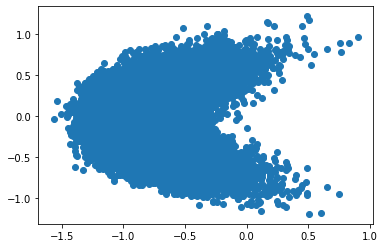

In [8]:
# Train model
timesteps = 200
# betas = linear_beta_schedule(timesteps)
betas = linear_beta_schedule(timesteps)
alphas = 1 - betas
alphas_ = torch.cumprod(alphas, axis=0)
variance = 1 - alphas_
sd = torch.sqrt(variance)

import torch.nn.functional as F

alphas_prev_ = F.pad(alphas_[:-1], [1, 0], "constant", 1.0)
sigma_squared_q_t = (1 - alphas) * (1 - alphas_) / (1 - alphas_prev_)
log_sigma_squared_q_t = torch.log(1-alphas) + torch.log(1-alphas_) - torch.log(1-alphas_prev_)
sigma_squared_q_t_corrected = torch.exp(log_sigma_squared_q_t)

# how to add noise to the data
def get_noisy(batch, timestep):
    # we will use the reparameterization trick
    noise_at_t = torch.normal(0, std=1, size=batch.size())
    added_noise_at_t = batch.mul(torch.sqrt(alphas_[timestep])) + noise_at_t.mul(sd[timestep])
    return added_noise_at_t, noise_at_t

def recover_original(batch, timestep, noise):
    true_data = (batch.sub(noise.mul(sd[timestep]))).div(alphas_[timestep])
    return true_data
    
# def reverse_noisy(batch_pred, timestep):

added_noise_at_t, noise = get_noisy(data_transformed, 20)
plt.scatter(added_noise_at_t[0], added_noise_at_t[1])

posterior_variance = (betas) * (1 - alphas_prev_) / (1 - alphas_)

## https://github.com/hojonathanho/diffusion/blob/1e0dceb3b3495bbe19116a5e1b3596cd0706c543/diffusion_tf/diffusion_utils_2.py#L196
## https://github.com/hojonathanho/diffusion/blob/1e0dceb3b3495bbe19116a5e1b3596cd0706c543/diffusion_tf/diffusion_utils_2.py#L78
log_posterior_variance = torch.log(torch.hstack([posterior_variance[1], posterior_variance[1:]]))

# not sure why we are multiplying by 1/2 here
posterior_variance_corrected = torch.exp(log_posterior_variance)

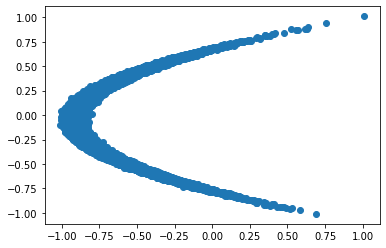

In [9]:
true_data = recover_original(added_noise_at_t, 20, noise)
plt.scatter(true_data[0], true_data[1])

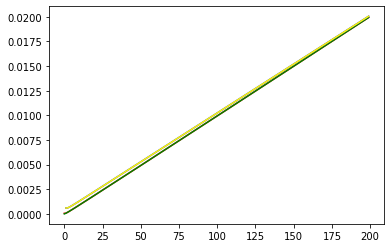

In [10]:
plt.plot(posterior_variance_corrected, c='red')
plt.plot(posterior_variance, c='green')
plt.plot(sigma_squared_q_t_corrected, c='blue')
plt.plot(sigma_squared_q_t, c='yellow')

# building a model

In [11]:
learning_rate = 1e-3
batch_size = 2048

from torch import nn

    
class DenoisingModelSequential(nn.Module):
    
    def __init__(self, hidden_units=32):
        super(DenoisingModelSequential, self).__init__()
        # hidden_units = 32
        
        self.mlp = nn.Sequential(
            nn.Linear(3, int(hidden_units), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units), int(hidden_units/2), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/2), int(hidden_units/4), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/4), int(hidden_units/8), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/8), int(hidden_units/16), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/16), int(hidden_units/8), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/8), int(hidden_units/4), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/4), int(hidden_units/2), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units/2), int(hidden_units), bias=True),
            nn.GELU(),
            nn.Linear(int(hidden_units), 2, bias=True)
        )
        
        
    def forward(self, x):
        x = self.mlp(x)
        return x
      
denoising_model = DenoisingModelSequential(64)
print(denoising_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(denoising_model.parameters(), lr=learning_rate)

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=64, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=64, out_features=32, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=32, out_features=16, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=16, out_features=8, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=8, out_features=4, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=4, out_features=8, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=8, out_features=16, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=16, out_features=32, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=32, out_features=64, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=64, out_features=2, bias=True)
  )
)


loss: 0.332187  [   10/ 2048]


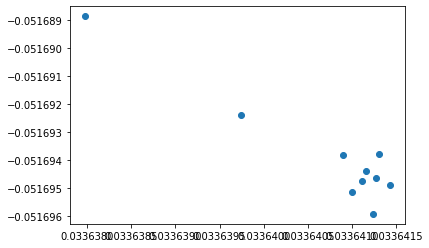

In [12]:
##### testing neural network above

test_noise_step = 5
data_noisy, noise = get_noisy(data_transformed[:, 0:10], test_noise_step)
# torch.hstack([data_noisy, torch.Tensor(5)])
t_ = torch.Tensor([test_noise_step])
t_ = t_.repeat(10)
data_noisy = torch.vstack([data_noisy, t_])

with torch.no_grad():
    for epoch in range(1, 2):
        data_pred = denoising_model(data_noisy.T)
        loss_ = loss_func(noise[:, 0:10].T, data_pred)
        loss, current = loss_.item(), 1 * 10
        print(f"loss: {loss:>7f}  [{current:>5d}/{batch_size:>5d}]")
    
# print(data_pred, data_transformed[:, 1:10].T)

plt.scatter(data_pred.T[0], data_pred.T[1])

In [13]:
# v = torch.sqrt(1/2 * (1/sigma_squared_q_t) * ((betas)**2 / ((1) * alphas)))

# plt.plot(v)

In [14]:
from copy import deepcopy
import pickle
import sys

def train_model(denoising_model, data_transformed, model_name, train_new_model=False, energy_method=False):
    best_loss = sys.float_info.max # initialization
        
    if train_new_model or not os.path.exists(osp.join(model_paths, model_name + '.pt')):
        losses = []
        for epoch in range(1, epochs+1):
            for n in range(1, int(len(data_transformed[0])/batch_size) + 1):
                data_in_batch = data_transformed[:, (n-1)*batch_size:(n*batch_size)]
                idx = torch.randint(0, timesteps-1, (batch_size, )).long()
                timestep = idx.add(1)
                data_noisy, noise = get_noisy(data_in_batch, timestep)
                optimizer.zero_grad(set_to_none=True)
                data_noisy_stacked = torch.vstack([data_noisy, timestep])
                pred_data = denoising_model(data_noisy_stacked.T)
                if not energy_method:
                    imp_weight = torch.sqrt(1/2 * (1/sigma_squared_q_t_corrected[timestep]) * ((betas[timestep])**2 / (variance[timestep] * alphas[timestep])))
                    # loss on prediction
                    loss_ = loss_func(noise.mul(imp_weight), pred_data.T.mul(imp_weight))
                else:
                    ## Energy function interpretation
                    imp_weight = torch.sqrt(1/2 * (1/sigma_squared_q_t_corrected[timestep]) * ((betas[timestep])**2 / (alphas[timestep])))
                    # loss on prediction
                    loss_ = loss_func(noise.div(-sd[timestep]).mul(imp_weight), pred_data.T.mul(imp_weight))


                loss_.backward()
                optimizer.step()
                
            ## evaluating noise on a fixed timestep to calculate best model
            with torch.no_grad():
                one_timestep = torch.Tensor([1]).repeat(batch_size).long()
                data_noisy_temp, noise_temp = get_noisy(data_in_batch, one_timestep)
                data_noisy_stacked_temp = torch.vstack([data_noisy_temp, one_timestep])
                pred_data_temp = denoising_model(data_noisy_stacked_temp.T)
                # loss on prediction
                if not energy_method:
                    loss_temp = loss_func(noise_temp.mul(1), pred_data_temp.T.mul(1))
                else:
                    loss_temp = loss_func(noise_temp.div(-sd[1]).mul(1), pred_data_temp.T.mul(1))
                losses.append(loss_temp.item())

            if loss_temp.item() < best_loss:
                best_loss = loss_temp.item()
                print(f"saving epoch: {epoch} loss: {best_loss:>7f}")
                if not dont_write:
                    torch.save(deepcopy(denoising_model.state_dict()), osp.join(model_paths, model_name + '.pt'))
                    write_cached([data_noisy, pred_data, data_in_batch, timestep, losses], osp.join(data_paths, model_name + '_state.pt'))

            if epoch % 20 == 0:
                loss = loss_temp.item()
                print(f"epoch: {epoch} loss: {loss:>7f}")
    if not dont_write:
      if os.path.exists(osp.join(model_paths, model_name + '.pt')):
          denoising_model.load_state_dict(torch.load(osp.join(model_paths, model_name + '.pt')))
          data_noisy, pred_data, data_in_batch, timestep, losses = load_cached(osp.join(data_paths, model_name + '_state.pt')) 
          return data_noisy, pred_data, data_in_batch, timestep, losses
    return data_noisy, pred_data, data_in_batch, timestep, losses

saving epoch: 1 loss: 0.427969
saving epoch: 4 loss: 0.416742
saving epoch: 11 loss: 0.411638
saving epoch: 13 loss: 0.411196
saving epoch: 15 loss: 0.398629
saving epoch: 16 loss: 0.393728
saving epoch: 17 loss: 0.390154
saving epoch: 19 loss: 0.377070
epoch: 20 loss: 0.394372
saving epoch: 24 loss: 0.376607
saving epoch: 25 loss: 0.369937
saving epoch: 31 loss: 0.366009
saving epoch: 37 loss: 0.356465
epoch: 40 loss: 0.363474
epoch: 60 loss: 0.387891
epoch: 80 loss: 0.396557
saving epoch: 89 loss: 0.353108
saving epoch: 90 loss: 0.349150
saving epoch: 95 loss: 0.338697
epoch: 100 loss: 0.349796


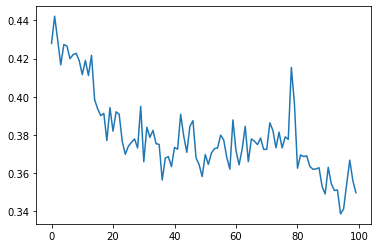

In [15]:
data_noisy, pred_data, data_in_batch, timestep, losses = train_model(denoising_model, data_transformed, 'pred_error_denoising_model.seq', train_new_model= (train_new_model | generate_new_data))
plt.plot(torch.Tensor(losses))

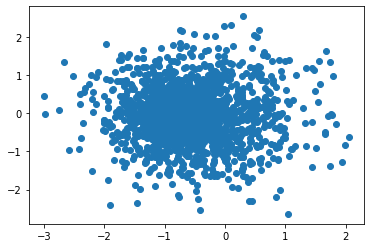

In [16]:
plt.scatter(data_noisy[0], data_noisy[1])

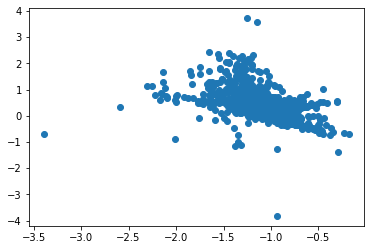

In [17]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

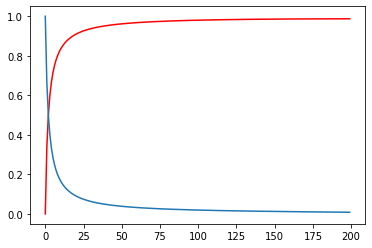

In [18]:
mean_coeff_1 = torch.sqrt(alphas)*(1 - alphas_prev_) / variance
mean_coeff_2 = torch.sqrt(alphas_prev_) * betas / variance

plt.plot(mean_coeff_1, color='red')
plt.plot(mean_coeff_2)

# mean_coeff_1, mean_coeff_2, alphas

In [19]:
def generate_data(denoising_model, tt=timesteps, energy_method=False, clipped_version=False):
    # final_step_data = get_noisy(data_transformed, timesteps-1)
    # mean_last_step = torch.mean(final_step_data, dim=1)
    # std_last_step = torch.std(final_step_data, dim=1)
    batch_size_generation = 2048
    # (tensor([0.4086, 0.4253]), tensor([-0.6379,  0.0137])))
    data_noisy =  torch.normal(mean=0, std=1, size=(2, batch_size_generation))
    # data_noisy_x =  torch.normal(mean=mean_last_step[0], std=std_last_step[0], size=(1, batch_size_generation))

    # data_noisy = torch.vstack([data_noisy_x, data_noisy_y])


    datas = []
    datas.append(data_noisy.cpu().detach())
    for n in range(1, int(len(data_noisy[0])/batch_size_generation) + 1):
        data_in_batch = data_noisy[:, (n-1)*batch_size_generation:(n*batch_size_generation)]
        for t in range(1, tt):
            timestep = tt-t
            t_repeated = torch.Tensor([timestep]).repeat(batch_size_generation)
            data_stacked = torch.vstack([data_in_batch, t_repeated])
            pred_data = denoising_model(data_stacked.T)
            if not clipped_version:
                if not energy_method:
                    #### Note: this implementation has numerical issues, so calculating it another way below to avoid numerical issues
                    # mean_data_1 = data_in_batch.T.mul(1/torch.sqrt(alphas_[timestep]))
                    # mean_data_2 = pred_data.mul((1-alphas[timestep])/(sd[timestep]*torch.sqrt(alphas[timestep])))
                    # mean_data = mean_data_1.sub(mean_data_2)
                    ######

                    # optimization:: not sure if exp(log(x) - log(y)) instead of x/y helps numerically
                    multiplier = torch.exp(torch.log((betas[timestep])) - torch.log(sd[timestep]))
                    mean_data = (data_in_batch.T.sub(pred_data.mul(multiplier))).div(torch.sqrt(alphas[timestep]))
                else:
                    ##
                    # Energy function interpretation
                    mean_data = (data_in_batch.T.add(pred_data.mul((betas[timestep])))).div(torch.sqrt(alphas[timestep]))
                    ##
            else:
                # clipping an improvement as recommended in https://github.com/hojonathanho/diffusion/blob/1e0dceb3b3495bbe19116a5e1b3596cd0706c543/diffusion_tf/diffusion_utils.py#L171
                # this helps in improving the samples generated as it keeps the random variables in the range of -1 to +1
                if not energy_method:
                    x_reconstructed = data_in_batch.T.sub(pred_data.mul(sd[timestep])).div(torch.sqrt(alphas_[timestep]))
                    if timestep >= 5:
                        x_reconstructed = torch.clip(x_reconstructed, -1., 1.)
                else:
                    # energy method and clipping to improve stabalization
                    x_reconstructed = data_in_batch.T.add(pred_data.mul(variance[timestep])).div(torch.sqrt(alphas_[timestep]))
                    if timestep >= 5:
                        x_reconstructed = torch.clip(x_reconstructed, -1., 1.)
                
                mean_data_1 = data_in_batch.T.mul(mean_coeff_1[timestep])
                mean_data_2 = x_reconstructed.mul(mean_coeff_2[timestep])
                mean_data = mean_data_1.add(mean_data_2)
                    
                

            posterior_data = posterior_variance_corrected[timestep]
            data_in_batch = torch.normal(mean_data, torch.sqrt(posterior_data)).T
            datas.append(data_in_batch.cpu().detach())
    return datas, data_in_batch

tt = 200
datas, data_in_batch = generate_data(denoising_model, tt, clipped_version=False)

(-20.0, 20.0)

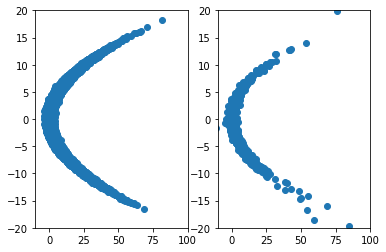

In [20]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_, max_)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(data[0], data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-10, 100])
ax1.set_ylim([-20, 20])

ax2.set_xlim([-10, 100])
ax2.set_ylim([-20, 20])

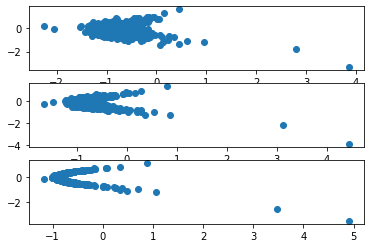

In [21]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

In [22]:
!pip install imageio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


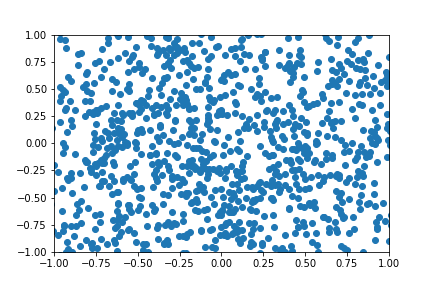

In [23]:
import imageio 
from IPython.display import Image

def print_gif(datas, name):
  filenames = []
  for i in range(0, tt-20, 10):
    # plot the line chart
    plt.scatter(datas[i][0], datas[i][1])
    plt.ylim(-1,1)
    plt.xlim(-1, 1)

    # create file name and append it to a list
    filename = f'para-{i}.png'
    filenames.append(filename)

    # save frame
    plt.savefig(filename)
    plt.close()
    
  for j in range(tt-20, tt-1, 1):
    # plot the line chart
    plt.scatter(datas[j][0], datas[j][1])
    plt.ylim(-1,1)
    plt.xlim(-1, 1)

    # create file name and append it to a list
    filename = f'para-{i+j}.png'
    filenames.append(filename)

    # save frame
    plt.savefig(filename)
    plt.close()

  images = list(map(lambda filename: imageio.imread(filename), filenames))
      
  imageio.mimsave(os.path.join(name), images, fps=3) # modify the frame duration as needed

  # Remove files
  for filename in set(filenames):
      os.remove(filename)
  with open(name,'rb') as f:
    display(Image(data=f.read(), format='png'))
  

print_gif(datas, 'para.gif')

# trying out different sklearn moon distributions

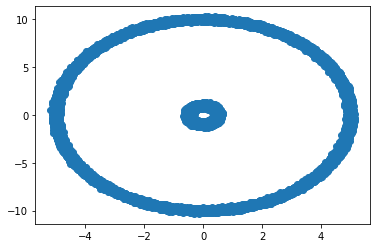

In [24]:
from sklearn import datasets
from matplotlib import pyplot as plt

if generate_new_data:
    circles, _ = datasets.make_circles(1024*128, noise=0.01, factor=0.1, shuffle=True)
    circles = circles* [5., 10.] 
    circles = circles.T
    if not dont_write:
      write_cached(circles, os.path.join(data_paths, '2.circle.pkl'))
else:
    circles = load_cached(os.path.join(data_paths, '2.circle.pkl'))

plt.scatter(circles[0], circles[1])

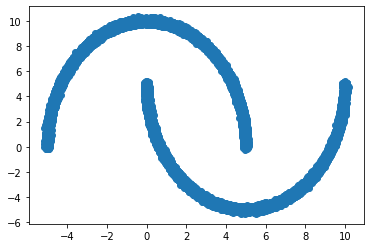

In [25]:
if generate_new_data:
    make_moons, labels = datasets.make_moons(n_samples=1024*128, noise=0.01)
    make_moons = make_moons* [5., 10.] 
    make_moons = make_moons.T
    if not dont_write:
      write_cached(make_moons, os.path.join(data_paths, '2.moons.pkl'))
else:
    make_moons = load_cached(os.path.join(data_paths, '2.moons.pkl'))
plt.scatter(make_moons[0], make_moons[1])

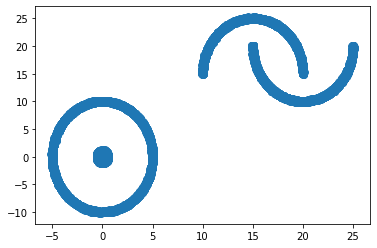

In [26]:
import numpy
if generate_new_data:
    complex_data = numpy.hstack([make_moons + 15, circles ]) 
    numpy.random.shuffle(complex_data.T)
    if not dont_write:
      write_cached(complex_data, os.path.join(data_paths, '2.complex.pkl'))
else:
    complex_data = load_cached(os.path.join(data_paths, '2.complex.pkl'))

plt.scatter(complex_data[0], complex_data[1])

#### train models

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 0.432371
s

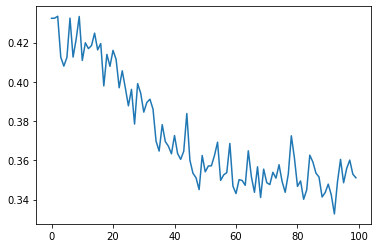

In [27]:
make_circles_model = DenoisingModelSequential(128)
print(make_circles_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_circles_model.parameters(), lr=learning_rate)

circles = torch.Tensor(circles)
circles_normalized, min_circles, max_circles = transform(circles)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_circles_model, circles_normalized, 'pred_error_make_circles_model.seq', train_new_model=(train_new_model | generate_new_data))
plt.plot(torch.Tensor(losses))

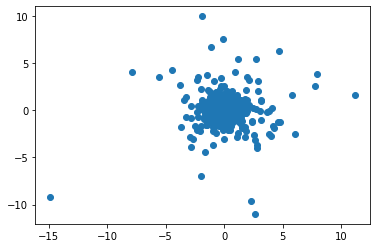

In [28]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

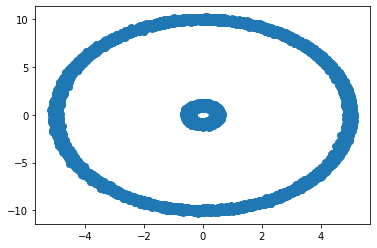

In [29]:
temp, noise = get_noisy(circles, 1)
plt.scatter(temp[0], temp[1])

In [30]:
tt = timesteps
datas, data_in_batch = generate_data(make_circles_model, tt)

(-10.0, 10.0)

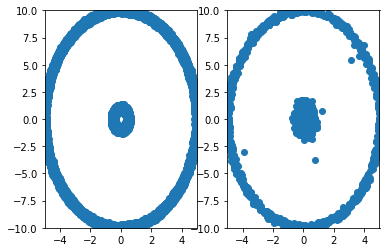

In [31]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_circles, max_circles)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(circles[0], circles[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 5])
ax1.set_ylim([-10, 10])

ax2.set_xlim([-5, 5])
ax2.set_ylim([-10, 10])

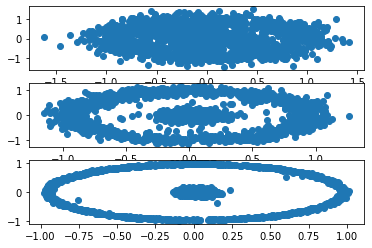

In [32]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

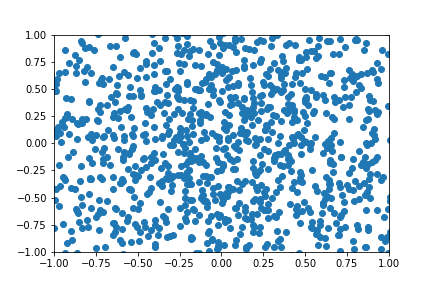

In [33]:
print_gif(datas, 'circles.gif')

#### make moons

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 0.424501
s

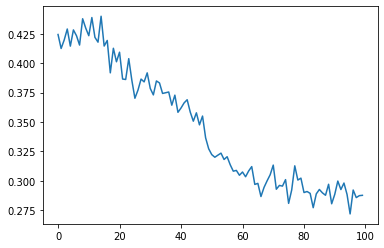

In [34]:
make_moons_model = DenoisingModelSequential(128)
print(make_moons_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_moons_model.parameters(), lr=learning_rate)

make_moons = torch.Tensor(make_moons)
make_moons_normalized, min_moons, max_moons = transform(make_moons)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_moons_model, make_moons_normalized, 'pred_error_make_moons_model.seq', train_new_model=(train_new_model | generate_new_data))
plt.plot(torch.Tensor(losses))

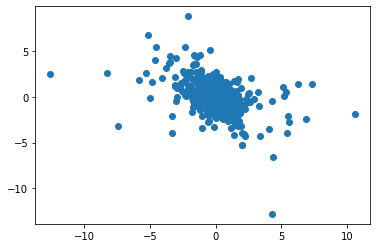

In [35]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

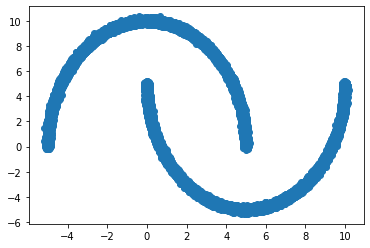

In [36]:
temp, noise = get_noisy(make_moons, 1)
plt.scatter(temp[0], temp[1])

In [37]:
tt=timesteps
datas, data_in_batch = generate_data(make_moons_model, tt)

(-10.0, 10.0)

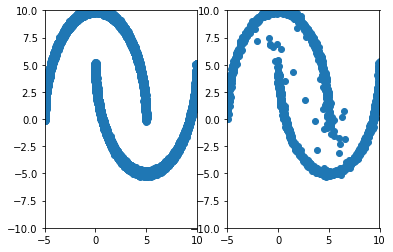

In [38]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_moons, max_moons)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(make_moons[0], make_moons[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 10])
ax1.set_ylim([-10, 10])

ax2.set_xlim([-5, 10])
ax2.set_ylim([-10, 10])

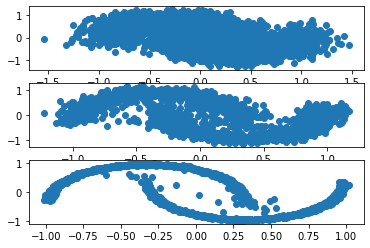

In [39]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

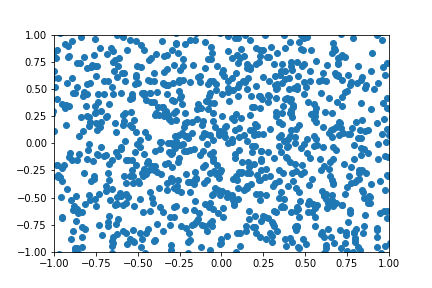

In [40]:
print_gif(datas, 'moons.gif')

#### complex data distribution

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 0.430400
s

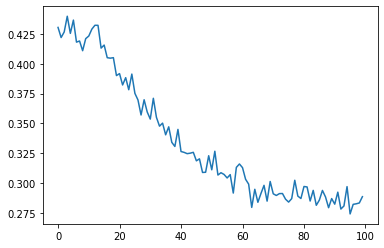

In [41]:
make_complex_model = DenoisingModelSequential(128)
print(make_complex_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_complex_model.parameters(), lr=learning_rate)

complex_data = torch.Tensor(complex_data)
complex_data_normalized, min_complex, max_complex = transform(complex_data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_complex_model, complex_data_normalized, 'pred_error_make_complex_model.seq', train_new_model=(train_new_model | generate_new_data))
plt.plot(torch.Tensor(losses))

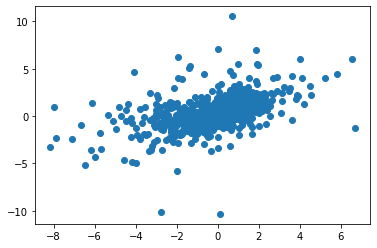

In [42]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

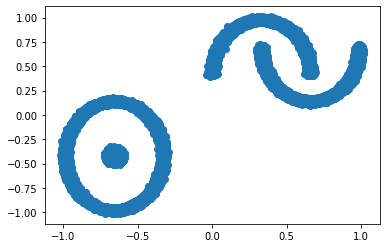

In [43]:
temp, noise = get_noisy(complex_data_normalized, 0)
plt.scatter(temp[0], temp[1])

In [44]:
tt=timesteps
datas, data_in_batch = generate_data(make_complex_model, tt)

(-10.0, 30.0)

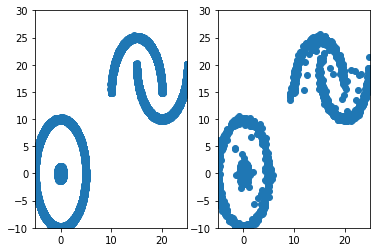

In [45]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_complex, max_complex)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(complex_data[0], complex_data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 25])
ax1.set_ylim([-10, 30])

ax2.set_xlim([-5, 25])
ax2.set_ylim([-10, 30])

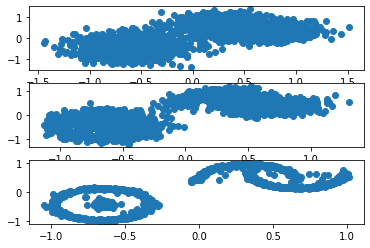

In [46]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

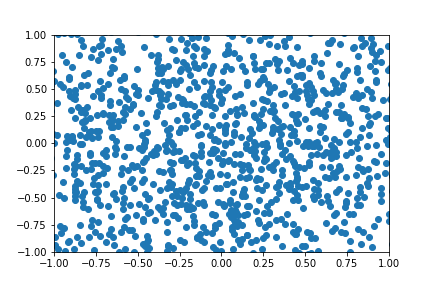

In [47]:
print_gif(datas, 'complex.gif')

----
# More models :) 
1. Energy based method
2. Clipped version
____

# Parabola Energy Method

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 46.009682


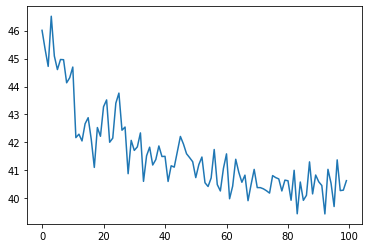

In [48]:
make_parabola_model = DenoisingModelSequential(128)
print(make_parabola_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_parabola_model.parameters(), lr=learning_rate)


data_transformed, min_, max_ = transform(data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_parabola_model, data_transformed, 'pred_error_make_parabola_model.energy_method', train_new_model=(train_new_model | generate_new_data), energy_method=True)
plt.plot(torch.Tensor(losses))

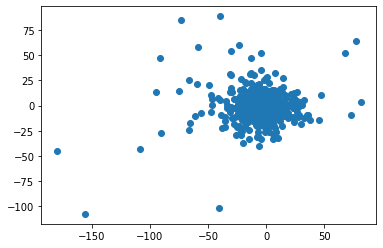

In [49]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

In [50]:
tt = timesteps
datas, data_in_batch = generate_data(make_parabola_model, tt, energy_method=True)

(-20.0, 20.0)

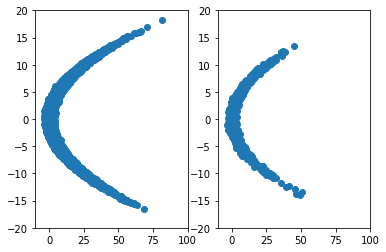

In [51]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_, max_)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(data[0], data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-10, 100])
ax1.set_ylim([-20, 20])

ax2.set_xlim([-10, 100])
ax2.set_ylim([-20, 20])

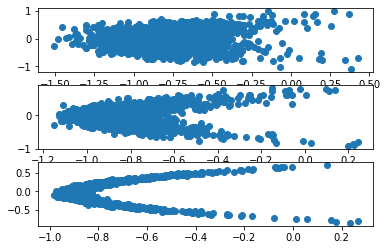

In [52]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

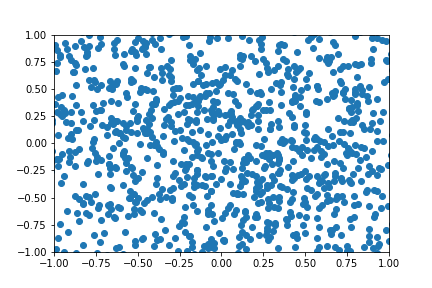

In [53]:
print_gif(datas, 'parabola_energy.gif')

# Complex Energy Method

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 44.318245


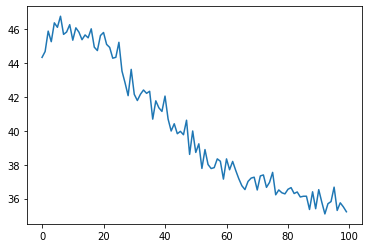

In [54]:
make_complex_model = DenoisingModelSequential(128)
print(make_complex_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_complex_model.parameters(), lr=learning_rate)


complex_data_transformed, min_complex, max_complex = transform(complex_data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_complex_model, complex_data_transformed, 'pred_error_make_complex_model.energy_method', train_new_model=(train_new_model | generate_new_data), energy_method=True)
plt.plot(torch.Tensor(losses))

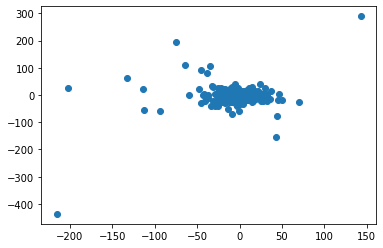

In [55]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

In [56]:
tt = timesteps
datas, data_in_batch = generate_data(make_complex_model, tt, energy_method=True)

(-10.0, 30.0)

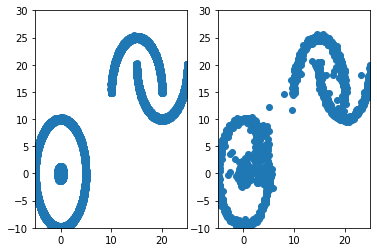

In [57]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_complex, max_complex)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(complex_data[0], complex_data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 25])
ax1.set_ylim([-10, 30])

ax2.set_xlim([-5, 25])
ax2.set_ylim([-10, 30])

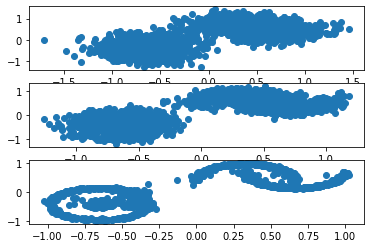

In [58]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

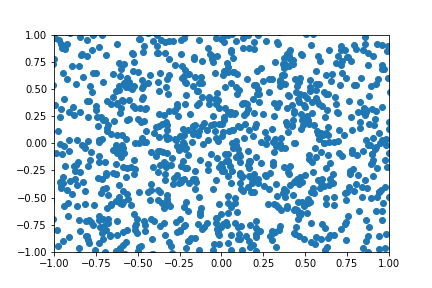

In [59]:
print_gif(datas, 'complex_energy.gif')

# Parabola clipped Version

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=64, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=64, out_features=32, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=32, out_features=16, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=16, out_features=8, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=8, out_features=4, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=4, out_features=8, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=8, out_features=16, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=16, out_features=32, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=32, out_features=64, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=64, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 0.434663
saving ep

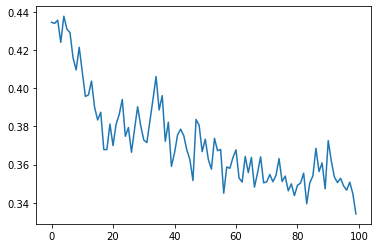

In [60]:
make_parabola_model = DenoisingModelSequential(64)
print(make_parabola_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_parabola_model.parameters(), lr=learning_rate)


data_transformed, min_, max_ = transform(data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_parabola_model, data_transformed, 'pred_error_denoising_model.seq', train_new_model=False, energy_method=False)
plt.plot(torch.Tensor(losses))

In [61]:
tt = timesteps
datas, data_in_batch = generate_data(make_parabola_model, tt, energy_method=False, clipped_version=True)

(-20.0, 20.0)

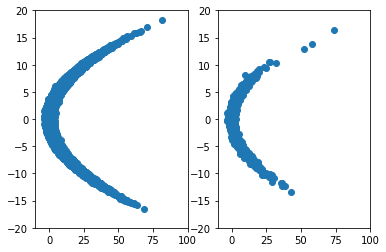

In [62]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_, max_)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(data[0], data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-10, 100])
ax1.set_ylim([-20, 20])

ax2.set_xlim([-10, 100])
ax2.set_ylim([-20, 20])

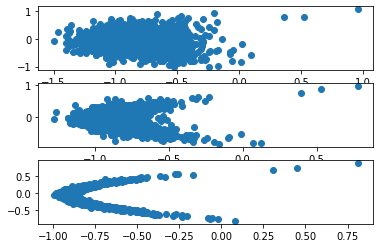

In [63]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

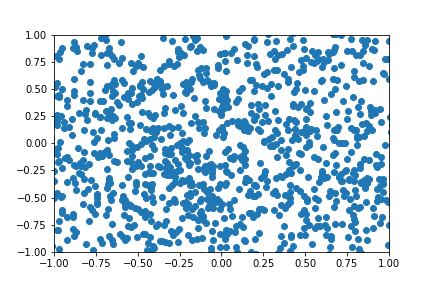

In [64]:
print_gif(datas, 'parabola_clipping.gif')

# Complex data clipped version

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 0.439733
s

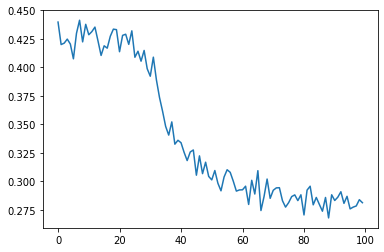

In [65]:
make_complex_model = DenoisingModelSequential(128)
print(make_complex_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_complex_model.parameters(), lr=learning_rate)


complex_data_transformed, min_complex, max_complex = transform(complex_data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_complex_model, complex_data_transformed, 'pred_error_make_complex_model.seq', train_new_model=False, energy_method=False)
plt.plot(torch.Tensor(losses))

In [66]:
tt = timesteps
datas, data_in_batch = generate_data(make_complex_model, tt, energy_method=False, clipped_version=True)

(-10.0, 30.0)

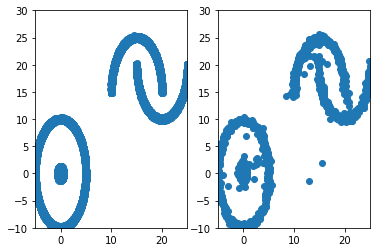

In [67]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_complex, max_complex)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(complex_data[0], complex_data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 25])
ax1.set_ylim([-10, 30])

ax2.set_xlim([-5, 25])
ax2.set_ylim([-10, 30])

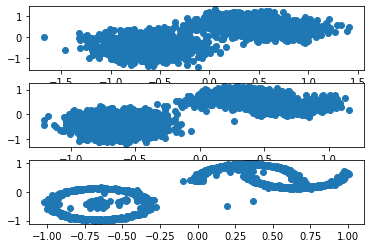

In [68]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

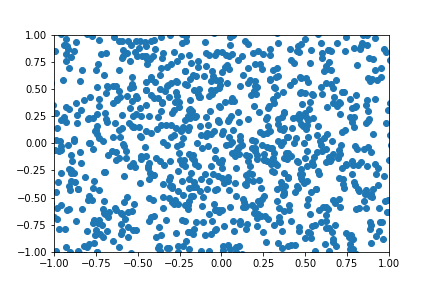

In [69]:
print_gif(datas, 'complex_clipping.gif')

# Complex Energy model with clipping

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 0.429012
s

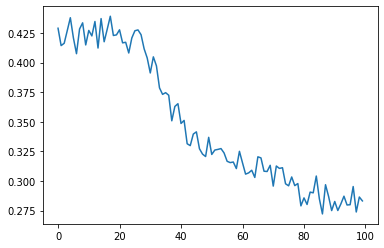

In [70]:
make_complex_model = DenoisingModelSequential(128)
print(make_complex_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_complex_model.parameters(), lr=learning_rate)


complex_data_transformed, min_complex, max_complex = transform(complex_data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_complex_model, complex_data_transformed, 'pred_error_make_complex_model.energy_method', train_new_model=False, energy_method=False)
plt.plot(torch.Tensor(losses))

In [71]:
tt = timesteps
datas, data_in_batch = generate_data(make_complex_model, tt, energy_method=True, clipped_version=True)

(-10.0, 30.0)

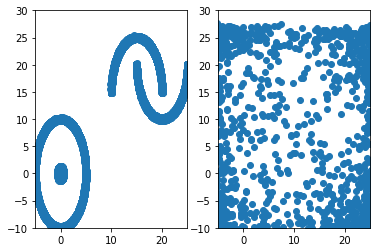

In [72]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_complex, max_complex)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(complex_data[0], complex_data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 25])
ax1.set_ylim([-10, 30])

ax2.set_xlim([-5, 25])
ax2.set_ylim([-10, 30])

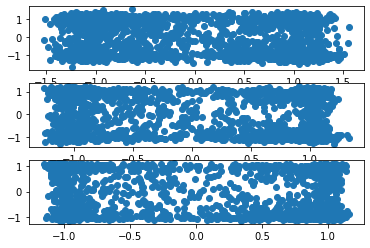

In [73]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

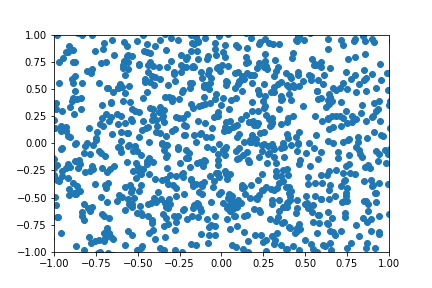

In [74]:
print_gif(datas, 'complex_clipping_energy.gif')

# cos schedule

#### Note:

* Linear schedule drop off for samller timestep for ex-200 is pretty linear, so a cosine schedule isn't quite needed
* linear schedules drop off rapidly for larger timesteps we need cosine schedule

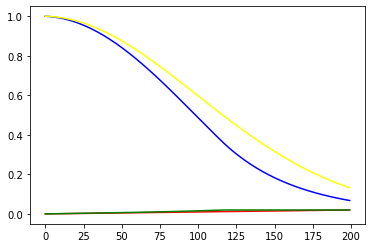

In [75]:
lin = linear_beta_schedule(200)
cos = cosine_beta_schedule(200)

plt.plot(lin, c='red')
plt.plot(cos, c='green')
plt.plot(torch.cumprod(1-cos, axis=0), c='blue')
plt.plot(torch.cumprod(1-lin, axis=0), c='yellow')

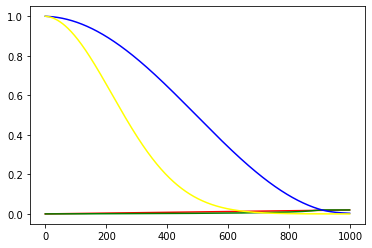

In [76]:
lin = linear_beta_schedule(1000)
cos = cosine_beta_schedule(1000)

plt.plot(lin, c='red')
plt.plot(cos, c='green')
plt.plot(torch.cumprod(1-cos, axis=0), c='blue')
plt.plot(torch.cumprod(1-lin, axis=0), c='yellow')

In [77]:
# Train model
timesteps = 200
# betas = linear_beta_schedule(timesteps)
betas = cosine_beta_schedule(timesteps)
alphas = 1 - betas
alphas_ = torch.cumprod(alphas, axis=0)
variance = 1 - alphas_
sd = torch.sqrt(variance)

import torch.nn.functional as F

alphas_prev_ = F.pad(alphas_[:-1], [1, 0], "constant", 1.0)
sigma_squared_q_t = (1 - alphas) * (1 - alphas_) / (1 - alphas_prev_)
log_sigma_squared_q_t = torch.log(1-alphas) + torch.log(1-alphas_) - torch.log(1-alphas_prev_)
sigma_squared_q_t_corrected = torch.exp(log_sigma_squared_q_t)

posterior_variance = (betas) * (1 - alphas_prev_) / (1 - alphas_)

## https://github.com/hojonathanho/diffusion/blob/1e0dceb3b3495bbe19116a5e1b3596cd0706c543/diffusion_tf/diffusion_utils_2.py#L196
## https://github.com/hojonathanho/diffusion/blob/1e0dceb3b3495bbe19116a5e1b3596cd0706c543/diffusion_tf/diffusion_utils_2.py#L78
log_posterior_variance = torch.log(torch.hstack([posterior_variance[1], posterior_variance[1:]]))

# not sure why we are multiplying by 1/2 here
posterior_variance_corrected = torch.exp(log_posterior_variance)

# Complex Energy Method Cosine schedule

DenoisingModelSequential(
  (mlp): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): GELU(approximate='none')
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): GELU(approximate='none')
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): GELU(approximate='none')
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): GELU(approximate='none')
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): GELU(approximate='none')
    (10): Linear(in_features=8, out_features=16, bias=True)
    (11): GELU(approximate='none')
    (12): Linear(in_features=16, out_features=32, bias=True)
    (13): GELU(approximate='none')
    (14): Linear(in_features=32, out_features=64, bias=True)
    (15): GELU(approximate='none')
    (16): Linear(in_features=64, out_features=128, bias=True)
    (17): GELU(approximate='none')
    (18): Linear(in_features=128, out_features=2, bias=True)
  )
)
saving epoch: 1 loss: 31.129684


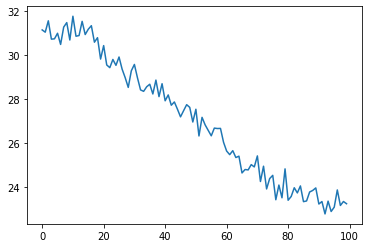

In [78]:
make_complex_model = DenoisingModelSequential(128)
print(make_complex_model)

loss_func = nn.HuberLoss()
optimizer = torch.optim.Adam(make_complex_model.parameters(), lr=learning_rate)


complex_data_transformed, min_complex, max_complex = transform(complex_data)
data_noisy, pred_data, data_in_batch, _, losses = train_model(make_complex_model, complex_data_transformed, 'pred_error_make_complex_model.energy_method.cosine_schedule', train_new_model=(train_new_model | generate_new_data), energy_method=True)
plt.plot(torch.Tensor(losses))

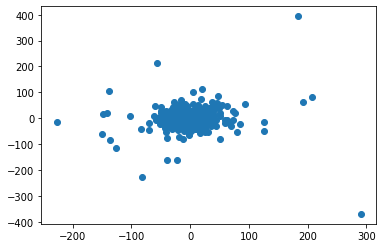

In [79]:
true_data = recover_original(data_noisy, timestep, pred_data.T).detach().numpy()
plt.scatter(true_data[0], true_data[1])

In [80]:
tt = timesteps
datas, data_in_batch = generate_data(make_complex_model, tt, energy_method=True, clipped_version=True)

(-10.0, 30.0)

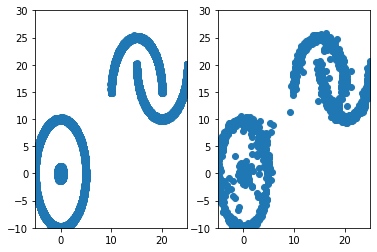

In [81]:
data_in_batch = data_in_batch.cpu().detach()
data_pred = reverse_transform(data_in_batch.cpu().detach(), min_complex, max_complex)
_, (ax1, ax2) = plt.subplots(1, 2)

ax1.scatter(complex_data[0], complex_data[1])
ax2.scatter(data_pred[0], data_pred[1])
ax1.set_xlim([-5, 25])
ax1.set_ylim([-10, 30])

ax2.set_xlim([-5, 25])
ax2.set_ylim([-10, 30])

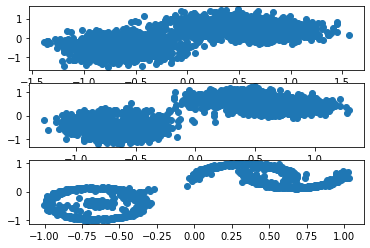

In [82]:
_, (ax5, ax6, ax7) = plt.subplots(3)

ax5.scatter(datas[tt - 25][0], datas[tt - 25][1])
ax6.scatter(datas[tt - 12][0], datas[tt - 12][1])
ax7.scatter(datas[tt - 1][0], datas[tt - 1][1])

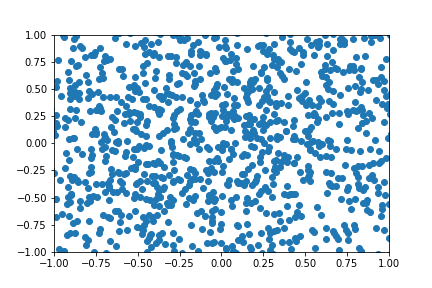

In [83]:
print_gif(datas, 'complex_energy_cosine.gif')